# Leicester City's 2015–16 Premier League Title: A Data-Driven Fairytale

<img src="https://upload.wikimedia.org/wikipedia/en/thumb/2/2d/Leicester_City_crest.svg/250px-Leicester_City_crest.svg.png" width="200" height="200">

## 🎯 Objective:
To analyze how Leicester City, a team given 5000/1 odds to win the title, defied expectations and captured the Premier League trophy in the 2015–16 season.

## Key Topics Covered:
- Tactical identity and formation stability  
- Possession strategy and counter-attacks  
- Defensive resilience and attacking efficiency  
- Key players like Jamie Vardy, Riyad Mahrez, N'Golo Kanté  
- Match patterns and goal timing

## Tools used:  
`pandas`, `matplotlib`, `seaborn`, `mplsoccer`, `statsbombpy`, `networkx`

**👨‍💻 Author:** Rishiraj Sinharay

In [35]:
# Installing libraries
! pip install mplsoccer --quiet
! pip install statsbombpy --quiet

In [145]:
# Import libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict, Counter
from mplsoccer import Pitch, VerticalPitch
import plotly.graph_objects as go
from statsbombpy import sb
import matplotlib.cm as cm
import matplotlib.colors as mcolors

In [37]:
# Define Leicester City Colors
blue = '#003090'
gold = '#FDBE11'
white = '#FFFFFF'

# Set display and plot styles
sns.set(style="whitegrid")

In [6]:
free_comps = sb.competitions()

In [7]:
free_comps[(free_comps['competition_name']=='Premier League') & (free_comps['season_name'] == '2015/2016')]

,competition_id,season_id,country_name,competition_name,competition_gender,competition_youth,competition_international,season_name,match_updated,match_updated_360,match_available_360,match_available
64,2,27,England,Premier League,male,False,False,2015/2016,2024-06-12T07:43:56.243851,2021-06-13T16:17:31.694,None,2024-06-12T07:43:56.243851


Leicester City's winning season has `competition_id = 2` and `season_id = 27`

In [8]:
# Getting all premier league match data from the 2015/16 season
matches = sb.matches(competition_id=2, season_id=27)

In [9]:
matches.head()

,match_id,match_date,kick_off,competition,season,home_team,away_team,home_score,away_score,match_status,...,last_updated_360,match_week,competition_stage,stadium,referee,home_managers,away_managers,data_version,shot_fidelity_version,xy_fidelity_version
0,3754058,2016-01-02,16:00:00.000,England - Premier League,2015/2016,Leicester City,AFC Bournemouth,0,0,available,...,2021-06-12T16:17:31.694,20,Regular Season,King Power Stadium,Andre Marriner,Claudio Ranieri,Eddie Howe,1.1.0,2,2
1,3754245,2015-10-17,16:00:00.000,England - Premier League,2015/2016,West Bromwich Albion,Sunderland,1,0,available,...,2021-06-13T16:17:31.694,9,Regular Season,The Hawthorns,Martin Atkinson,Tony Pulis,Sam Allardyce,1.1.0,2,2
2,3754136,2015-12-19,18:30:00.000,England - Premier League,2015/2016,Newcastle United,Aston Villa,1,1,available,...,2021-06-13T16:17:31.694,17,Regular Season,St. James'' Park,Martin Atkinson,Steve McClaren,Rémi Garde,1.1.0,2,2
3,3754037,2016-04-30,16:00:00.000,England - Premier League,2015/2016,Everton,AFC Bournemouth,2,1,available,...,2021-06-12T16:17:31.694,36,Regular Season,Goodison Park,Neil Swarbrick,Roberto Martínez Montoliú,Eddie Howe,1.1.0,2,2
4,3754039,2016-02-13,16:00:00.000,England - Premier League,2015/2016,Crystal Palace,Watford,1,2,available,...,2021-06-12T16:17:31.694,26,Regular Season,Selhurst Park,Robert Madley,Alan Pardew,Enrique Sánchez Flores,1.1.0,2,2


In [10]:
matches.columns

Index(['match_id', 'match_date', 'kick_off', 'competition', 'season',
       'home_team', 'away_team', 'home_score', 'away_score', 'match_status',
       'match_status_360', 'last_updated', 'last_updated_360', 'match_week',
       'competition_stage', 'stadium', 'referee', 'home_managers',
       'away_managers', 'data_version', 'shot_fidelity_version',
       'xy_fidelity_version'],
      dtype='object')

In [11]:
# Filtering Leicester's matches
lc_matches = matches[(matches['home_team']=='Leicester City') | (matches['away_team']=='Leicester City')]


## 1. Basic Season Stats Overview

Before diving into tactics and player performance, it's essential to understand the raw outcomes that defined Leicester City’s historic 2015–16 season.

The Foxes, led by Claudio Ranieri, played 38 games, won 23, lost just 3, and drew 12—finishing the league with 81 points.

Let’s extract their:
- Total games
- Wins, losses, draws
- Goals scored & conceded
- Clean sheets
- Total points

In [40]:
# Count total matches
total_matches = lc_matches.shape[0]

In [41]:
# Calculate wins, draws, losses
wins = lc_matches.apply(lambda x: (
    (x['home_score'] > x['away_score'] and x['home_team'] == "Leicester City") or
    (x['away_score'] > x['home_score'] and x['away_team'] == "Leicester City")
), axis=1).sum()

draws = lc_matches.apply(lambda x: x['home_score'] == x['away_score'], axis=1).sum()
losses = total_matches - wins - draws

In [42]:
# Points
points = wins * 3 + draws

# Goals scored
goals_scored = lc_matches.apply(lambda x: x['home_score'] if x['home_team'] == "Leicester City" else x['away_score'], axis=1).sum()

# Goals conceded
goals_conceded = lc_matches.apply(lambda x: x['away_score'] if x['home_team'] == "Leicester City" else x['home_score'], axis=1).sum()

# Goal difference
goal_difference = goals_scored - goals_conceded

# Clean sheets
clean_sheets = 0
for _, row in lc_matches.iterrows():
    if row['home_team'] == 'Leicester City' and row['away_score'] == 0:
        clean_sheets += 1
    elif row['away_team'] == 'Leicester City' and row['home_score'] == 0:
        clean_sheets += 1

In [43]:
# Print summary
print(f"Matches: {total_matches}, Wins: {wins}, Draws: {draws}, Losses: {losses}")
print(f"Points: {points}, Goals Scored: {goals_scored}, Goals Conceded: {goals_conceded}, Goal Difference: {goal_difference}")
print(f"Clean Sheets: {clean_sheets}")

Matches: 38, Wins: 23, Draws: 12, Losses: 3
Points: 81, Goals Scored: 68, Goals Conceded: 36, Goal Difference: 32
Clean Sheets: 15


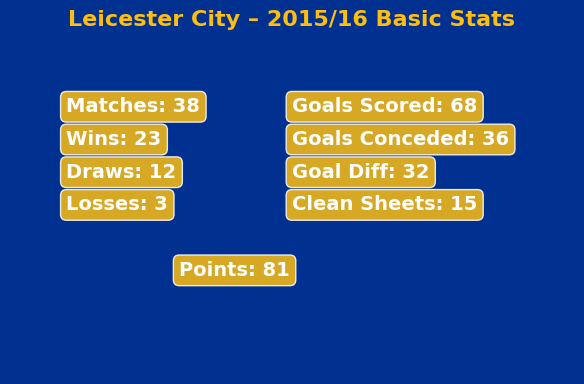

In [46]:
# Create stylized stat box
fig, ax = plt.subplots(figsize=(6, 4))
fig.patch.set_facecolor(blue)
ax.set_facecolor(blue)
ax.axis('off')

# Text content
text_items = [
    ("Matches", total_matches),
    ("Wins", wins),
    ("Draws", draws),
    ("Losses", losses),
    ("Goals Scored", goals_scored),
    ("Goals Conceded", goals_conceded),
    ("Goal Diff", goal_difference),
    ("Clean Sheets", clean_sheets),
    ("Points", points)
]

x_pos = [0.1,0.1, 0.1, 0.1, 0.5, 0.5, 0.5, 0.5, 0.3]
y_pos = [0.8, 0.7, 0.6, 0.5, 0.8, 0.7, 0.6, 0.5, 0.3]

for i, (label, value) in enumerate(text_items):
    ax.text(x_pos[i], y_pos[i], f"{label}: {value}",
            fontsize=14, color=white, fontweight='bold',
            transform=ax.transAxes,
            bbox=dict(facecolor=gold, alpha=0.85, boxstyle="round,pad=0.3"))

ax.set_title("Leicester City – 2015/16 Basic Stats", fontsize=16, color=gold, weight='bold', pad=15)
plt.tight_layout()
plt.show()


## 2. Tactical Identity & Formation Analysis

We’ll examine:
- The formations used
- Goals scored/conceded under each setup
- Match outcomes by formation

In [47]:
# Initialize dictionaries
formation_stats = defaultdict(lambda: {
    'matches': 0, 'goals_for': 0, 'goals_against': 0,
    'wins': 0, 'draws': 0, 'losses': 0
})

formation_minute_stats = defaultdict(lambda: defaultdict(lambda: {
    'goals_for': 0, 'goals_against': 0,
    'shots_for': 0, 'shots_against': 0
}))

# Loop through matches
for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    events = sb.events(match_id=match_id)

    # Get Starting XI and Tactical Changes for Leicester
    starting_11 = events[(events['type'] == 'Starting XI') & (events['team'] == 'Leicester City')]
    tactical_changes = events[(events['type'] == 'Tactical Shift') & (events['team'] == 'Leicester City')]

    # Build formation timeline
    formation_timeline = []
    if not starting_11.empty:
        formation_timeline.append({'formation': starting_11.iloc[0]['tactics']['formation'], 'minute': 0})
    for _, row in tactical_changes.iterrows():
        formation_timeline.append({'formation': row['tactics']['formation'], 'minute': row['minute']})
    formation_timeline = sorted(formation_timeline, key=lambda x: x['minute'])
    for i in range(len(formation_timeline)):
        formation_timeline[i]['end_minute'] = formation_timeline[i+1]['minute'] if i < len(formation_timeline)-1 else 91

    # Track shots/goals for each formation window
    shots = events[events['type'] == 'Shot']
    for _, shot in shots.iterrows():
        mnt = shot['minute']
        is_goal = shot.get('shot_outcome') == 'Goal'
        team = shot['team']
        for seg in formation_timeline:
            if seg['minute'] <= mnt < seg['end_minute']:
                f = seg['formation']
                if team == 'Leicester City':
                    formation_minute_stats[f][mnt]['shots_for'] += 1
                    if is_goal:
                        formation_minute_stats[f][mnt]['goals_for'] += 1
                        formation_stats[f]['goals_for'] += 1
                else:
                    formation_minute_stats[f][mnt]['shots_against'] += 1
                    if is_goal:
                        formation_minute_stats[f][mnt]['goals_against'] += 1
                        formation_stats[f]['goals_against'] += 1
                break

    # Result under final formation
    final_formation = formation_timeline[-1]['formation']
    formation_stats[final_formation]['matches'] += 1
    leicester_home = match['home_team'] == 'Leicester City'
    gf = match['home_score'] if leicester_home else match['away_score']
    ga = match['away_score'] if leicester_home else match['home_score']

    if gf > ga:
        formation_stats[final_formation]['wins'] += 1
    elif gf < ga:
        formation_stats[final_formation]['losses'] += 1
    else:
        formation_stats[final_formation]['draws'] += 1


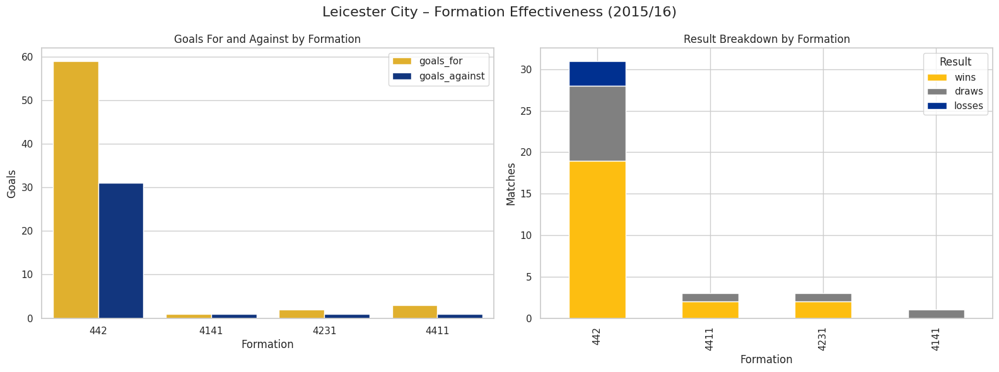

In [48]:
# Format into DataFrame
formation_df = pd.DataFrame.from_dict(formation_stats, orient='index').reset_index()
formation_df = formation_df.rename(columns={'index': 'Formation'})
formation_df = formation_df.sort_values(by='matches', ascending=False)

# Plot goals for/against
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

# Plot 1 – Goals For/Against
sns.barplot(data=formation_df.melt(id_vars='Formation', value_vars=['goals_for', 'goals_against']),
            x='Formation', y='value', hue='variable', ax=axes[0],
            palette=[gold, blue])
axes[0].set_title("Goals For and Against by Formation")
axes[0].set_ylabel("Goals")
axes[0].legend(title="")

# Plot 2 – Match Results
formation_df.set_index('Formation')[['wins', 'draws', 'losses']].plot(
    kind='bar', stacked=True, ax=axes[1],
    color=[gold, 'gray', blue]
)
axes[1].set_title("Result Breakdown by Formation")
axes[1].set_ylabel("Matches")
axes[1].legend(title="Result", loc='upper right')

plt.suptitle("Leicester City – Formation Effectiveness (2015/16)", fontsize=16)
plt.tight_layout()
plt.show()


One of Leicester City’s biggest strengths during the 2015–16 season was tactical consistency. While other clubs experimented, Ranieri’s men stuck with a mostly unchanging system.

The Foxes primarily operated in a **classic 4-4-2**, optimizing simplicity, compactness, and quick transitions.

## 3. Buil-Up Play & Passing Patterns

We’ll analyze:
- How passes and carries were distributed across player roles  
- How defenders, midfielders, and forwards moved and linked up  
- Average position maps and player networks

In [49]:
example_event = sb.events(match_id = lc_matches['match_id'][0]) # to get structure

In [50]:
# Extracting all of Leicester's events data

lc_events = pd.DataFrame(columns = example_event.columns )
for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    # Extract all match events
    events = sb.events(match_id=match_id)
    # Filter out Leicester City events
    lc_events = pd.concat([lc_events,events[(events['team'] == 'Leicester City')]], ignore_index=True)


<ipython-input-50-b90dc656e1c8>:9: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  lc_events = pd.concat([lc_events,events[(events['team'] == 'Leicester City')]], ignore_index=True)


In [51]:
# Get passes and carries
passes = lc_events[lc_events['type'] == 'Pass'].copy()
carries = lc_events[lc_events['type'] == 'Carry'].copy()

In [52]:
# Classify player roles
def get_role(pos):
    if 'Back' in pos or 'Goalkeeper' in pos:
        return 'Defender'
    elif 'Midfield' in pos:
        return 'Midfielder'
    else:
        return 'Forward'

In [53]:
passes['role'] = passes['position'].apply(get_role)
carries['role'] = carries['position'].apply(get_role)

### 3.1. Passing Network by Role
Passing networks help us visualize how each role group contributed to buildup. Let’s plot them for Defenders, Midfielders, and Forwards.

In [54]:
def plot_passing_network(role):
    position_passes = passes[passes['role'] == role]

    avg_positions = position_passes.groupby('player')['location'].apply(lambda x: np.mean(x.tolist(), axis=0))
    pass_pairs = position_passes[['player', 'pass_recipient']].dropna()
    pass_combos = Counter([tuple(x) for x in pass_pairs.values])
    touches = Counter(pass_pairs['player']) + Counter(pass_pairs['pass_recipient'])

    pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True)
    fig, ax = pitch.draw(figsize=(18, 10))
    ax.set_title(f'{role}s Passing Network – Leicester City', color='black', fontsize=16)

    for player, pos in avg_positions.items():
        touch_count = touches[player]
        marker_size = 50 + 6 * touch_count
        pitch.scatter(pos[0], pos[1], s=marker_size, color=blue, edgecolors='white', linewidth=2, ax=ax, zorder=3)
        ax.text(pos[0], pos[1], player.split()[-1], ha='center', va='top', fontsize=10 + marker_size/800, color='white', zorder=4)

    for (p1, p2), count in pass_combos.items():
        if p1 in avg_positions and p2 in avg_positions and count >= 2:
            start = avg_positions[p1]
            end = avg_positions[p2]
            dx, dy = end[0] - start[0], end[1] - start[1]
            pitch.arrows(start[0], start[1], end[0], end[1],
                         width=2, headwidth=5, headlength=5, headaxislength=3.5,
                         color='black', alpha=0.5 + 0.5 * (min(count, 10) / 10), ax=ax, zorder=2)

    plt.show()

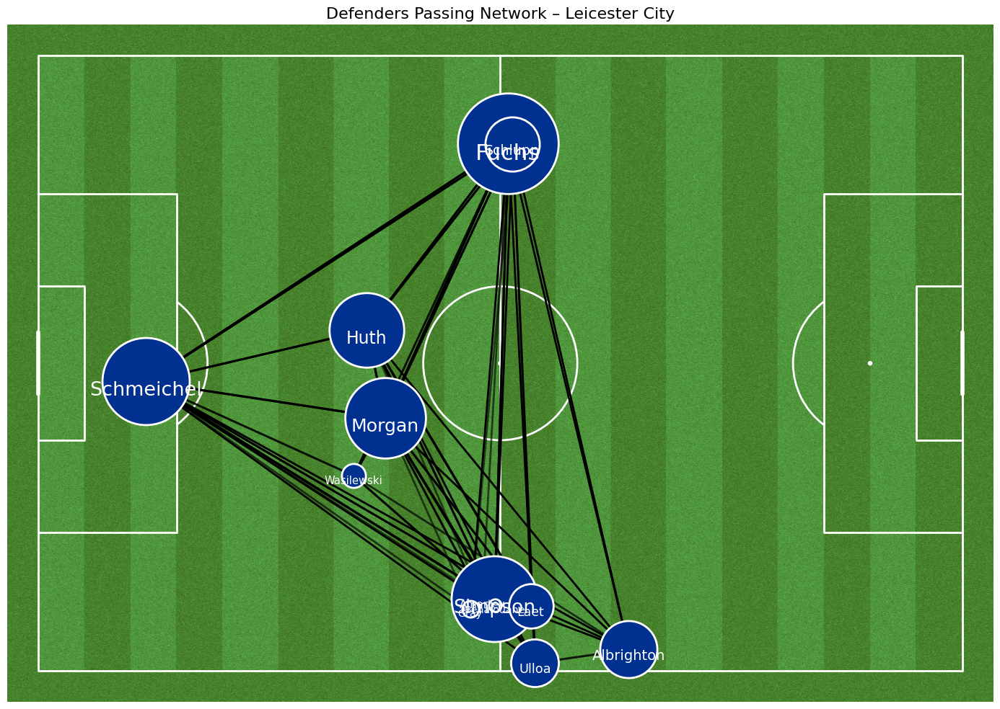

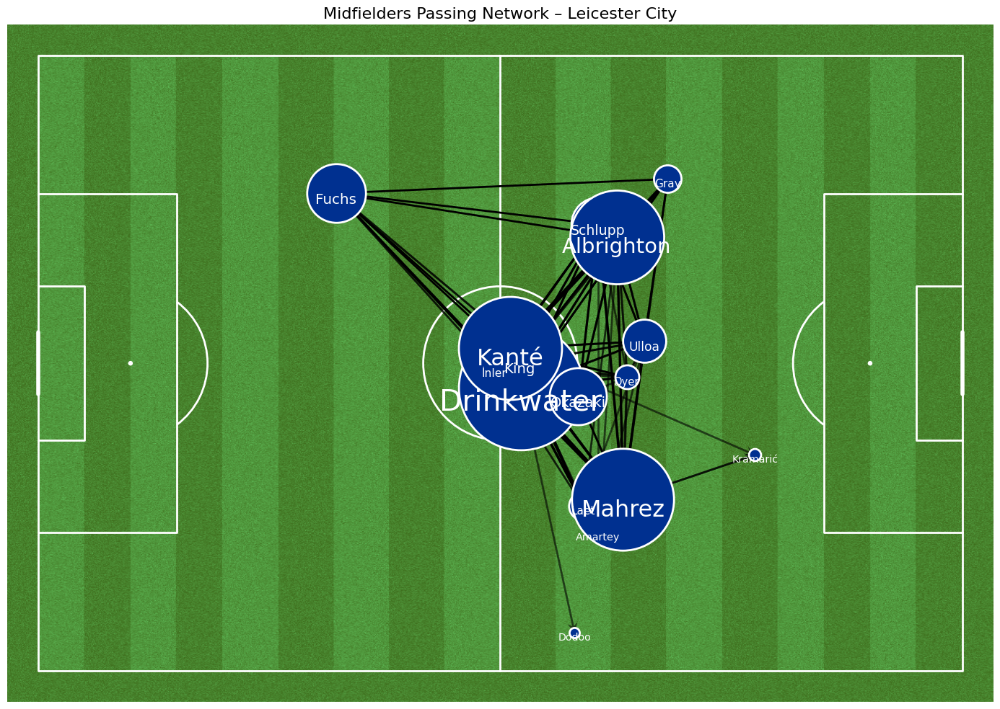

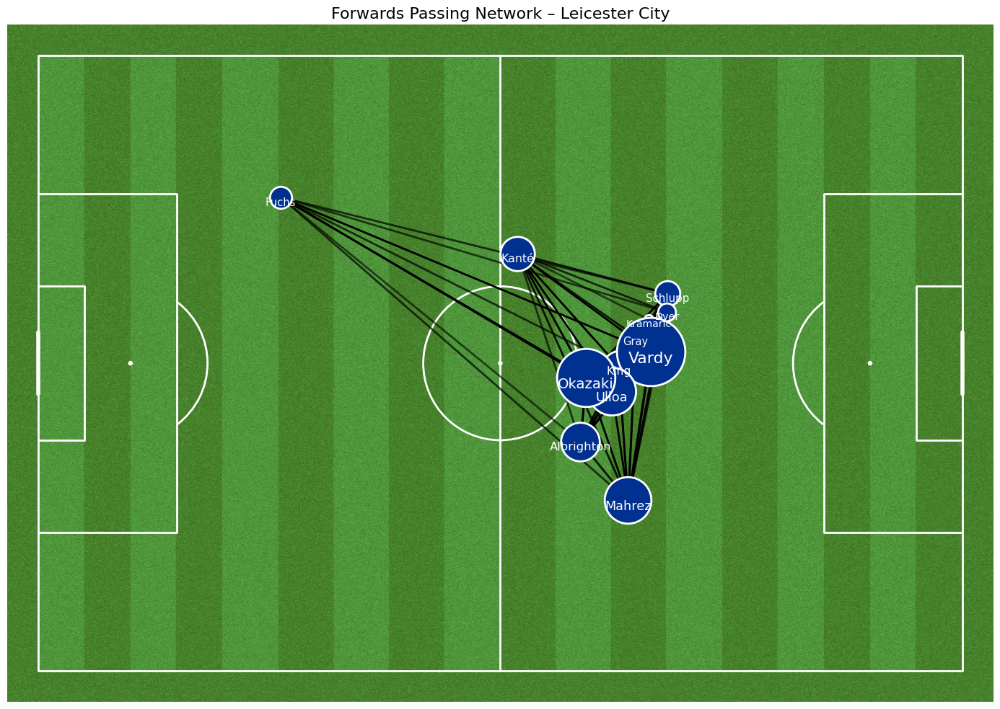

In [55]:
# Plot each role group
plot_passing_network('Defender')
plot_passing_network('Midfielder')
plot_passing_network('Forward')

### 3.2. Average Position Maps by Role
These plots show how Leicester players positioned themselves on the pitch by role. Expect compact lines and wide wingers like Mahrez.

In [56]:
# Combine passes + carries for movement data
movement_df = pd.concat([passes, carries]).dropna(subset=['player', 'location', 'position'])
avg_pos = movement_df.groupby(['player', 'role'])['location'].apply(lambda x: np.mean(x.tolist(), axis=0)).reset_index()
avg_pos[['x', 'y']] = pd.DataFrame(avg_pos['location'].tolist(), index=avg_pos.index)

role_colors = {
    'Defender': blue,
    'Midfielder': gold,
    'Forward': 'crimson'
}


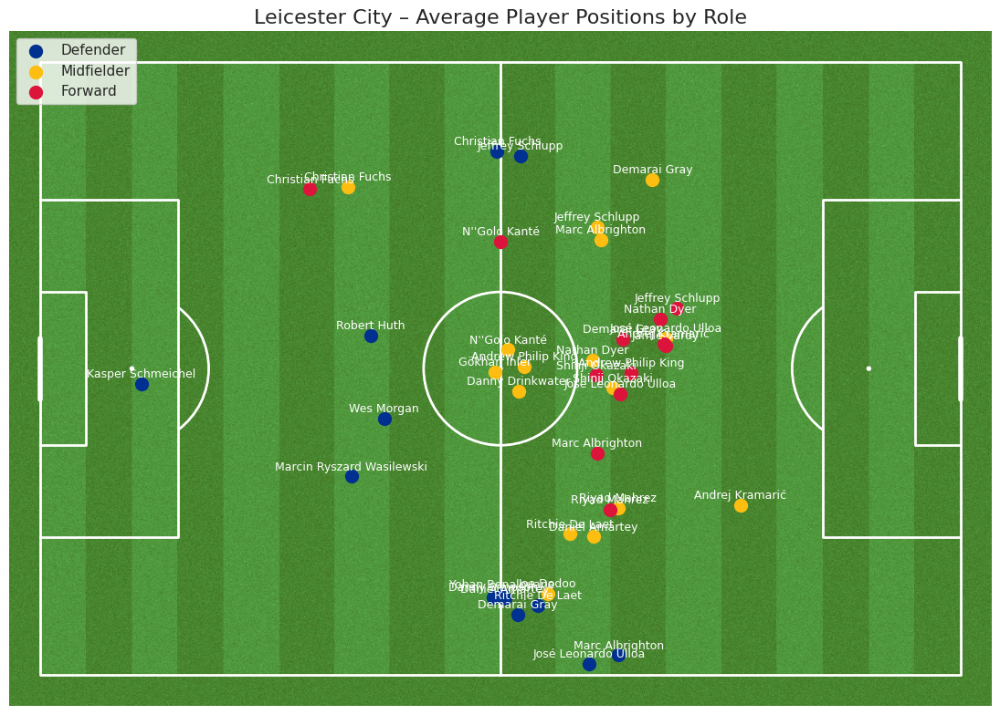

In [57]:
pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True)
fig, ax = pitch.draw(figsize=(16, 8))

for role in ['Defender', 'Midfielder', 'Forward']:
    role_data = avg_pos[avg_pos['role'] == role]
    pitch.scatter(role_data['x'], role_data['y'], color=role_colors[role], s=100, ax=ax, label=role)
    for _, row in role_data.iterrows():
        ax.text(row['x'], row['y'] - 2, row['player'], color='white', fontsize=9, ha='center', va='top')

plt.title("Leicester City – Average Player Positions by Role", fontsize=16)
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

### 3.3. Player Movement Heatmaps by Role
Heatmaps help us understand which pitch zones were most occupied by defenders, midfielders, and forwards. For Leicester, expect defensive compactness and wide activity from Mahrez.

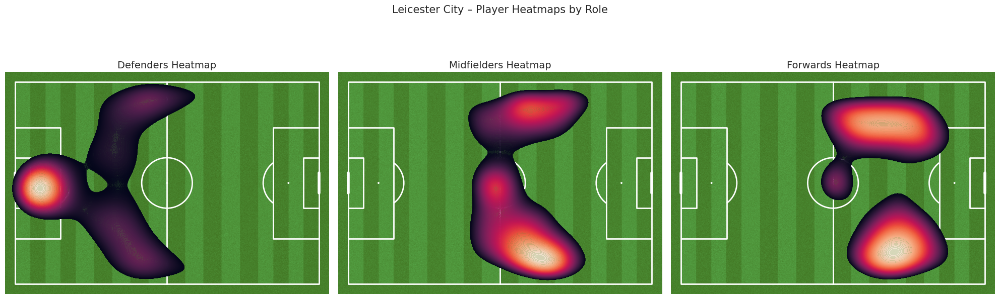

In [60]:
cmap = 'rocket'

pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True)
fig, axes = pitch.draw(nrows=1, ncols=3, figsize=(20, 7))
roles = ['Defender', 'Midfielder', 'Forward']

for ax, role in zip(axes.flat, roles):
    role_passes = passes[passes['role'] == role]['location'].dropna().tolist()
    role_carries = carries[carries['role'] == role]['location'].dropna().tolist()
    all_locs = np.array(role_passes + role_carries)

    if len(all_locs) > 0:
        sns.kdeplot(
            x=all_locs[:, 0],
            y=all_locs[:, 1],
            fill=True,
            cmap=cmap,
            alpha=0.8,
            bw_adjust=1.2,
            ax=ax,
            levels=200,
            thresh=0.6
        )
    ax.set_title(f"{role}s Heatmap", fontsize=14)

plt.suptitle("Leicester City – Player Heatmaps by Role", fontsize=15)
plt.tight_layout()
plt.show()


## 4. Posession Trends & Territory Analysis

Let’s explore:
- Minute-by-minute possession trend
- Possession share in defensive, middle, and attacking thirds

## 4.1. Minute-by-minute posession analysis

In [61]:
# Initialize counters
possession_minute_split = defaultdict(lambda: {
    'total': 0, 'leicester': 0,
    'home_total': 0, 'home_leicester': 0,
    'away_total': 0, 'away_leicester': 0
})

# Loop through all matches
for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    events = sb.events(match_id=match_id)

    leicester_home = match['home_team'] == 'Leicester City'

    for _, row in events.iterrows():
        minute = row['minute']
        team = row.get('possession_team')

        possession_minute_split[minute]['total'] += 1
        if team == 'Leicester City':
            possession_minute_split[minute]['leicester'] += 1

        if leicester_home:
            possession_minute_split[minute]['home_total'] += 1
            if team == 'Leicester City':
                possession_minute_split[minute]['home_leicester'] += 1
        else:
            possession_minute_split[minute]['away_total'] += 1
            if team == 'Leicester City':
                possession_minute_split[minute]['away_leicester'] += 1


In [62]:
# Convert to DataFrame
def pct(part, total): return (part / total) * 100 if total > 0 else 0

possession_split_stats = []

for minute in range(91):
    data = possession_minute_split[minute]
    possession_split_stats.append({
        'minute': minute,
        'overall_pct': pct(data['leicester'], data['total']),
        'home_pct': pct(data['home_leicester'], data['home_total']),
        'away_pct': pct(data['away_leicester'], data['away_total']),
    })

possession_split_df = pd.DataFrame(possession_split_stats)
avg_total_possession = possession_split_df['overall_pct'].mean()

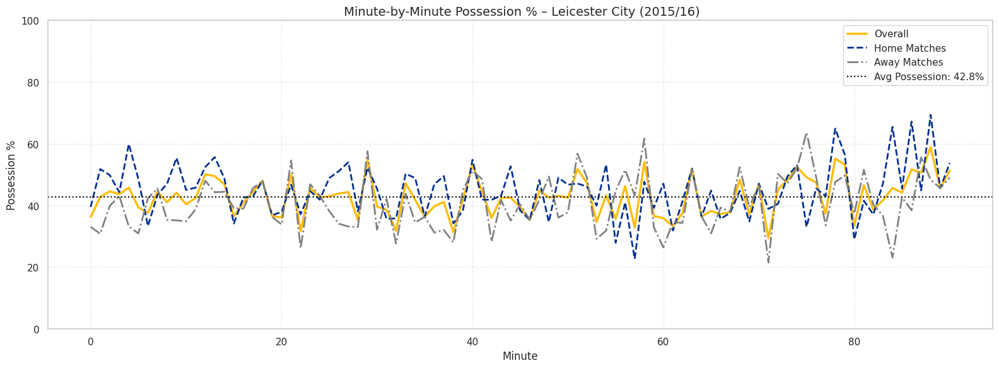

In [64]:
# Visualising minute-by-minute posession

plt.figure(figsize=(16, 6))

sns.lineplot(data=possession_split_df, x='minute', y='overall_pct', label='Overall', color=gold, linewidth=2.5)
sns.lineplot(data=possession_split_df, x='minute', y='home_pct', label='Home Matches', color=blue, linestyle='--', linewidth=2)
sns.lineplot(data=possession_split_df, x='minute', y='away_pct', label='Away Matches', color='gray', linestyle='-.', linewidth=2)

plt.axhline(y=avg_total_possession, color='black', linestyle=':', label=f'Avg Possession: {avg_total_possession:.1f}%', linewidth=1.5)

plt.title(" Minute-by-Minute Possession % – Leicester City (2015/16)", fontsize=14)
plt.xlabel("Minute")
plt.ylabel("Possession %")
plt.ylim(0, 100)
plt.grid(True, linestyle='--', alpha=0.4)
plt.legend()
plt.tight_layout()
plt.show()


Unlike traditional champions, Leicester didn’t rely on possession to control matches. They *averaged only ~43% possession*, often letting opponents have the ball before hitting them on the break.

## 4.2. Posession by Pitch Third
This visual shows which zones Leicester spent most of their possession in — defensive, middle, or attacking third.

Given their counterattacking style, expect heavy touches in the **middle and final third** followed by long, vertical plays.

In [65]:
# Territory counters
thirds_counter = {
    'defensive': 0,
    'middle': 0,
    'attacking': 0,
    'total': 0
}

# Loop through matches
for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    events = sb.events(match_id=match_id)

    for _, event in events.iterrows():
        if event['possession_team'] == 'Leicester City' and isinstance(event['location'], list):
            x = event['location'][0]
            if x < 33.3:
                thirds_counter['defensive'] += 1
            elif x < 66.6:
                thirds_counter['middle'] += 1
            else:
                thirds_counter['attacking'] += 1
            thirds_counter['total'] += 1

# Percentages
def_pct = (thirds_counter['defensive'] / thirds_counter['total']) * 100
mid_pct = (thirds_counter['middle'] / thirds_counter['total']) * 100
att_pct = (thirds_counter['attacking'] / thirds_counter['total']) * 100

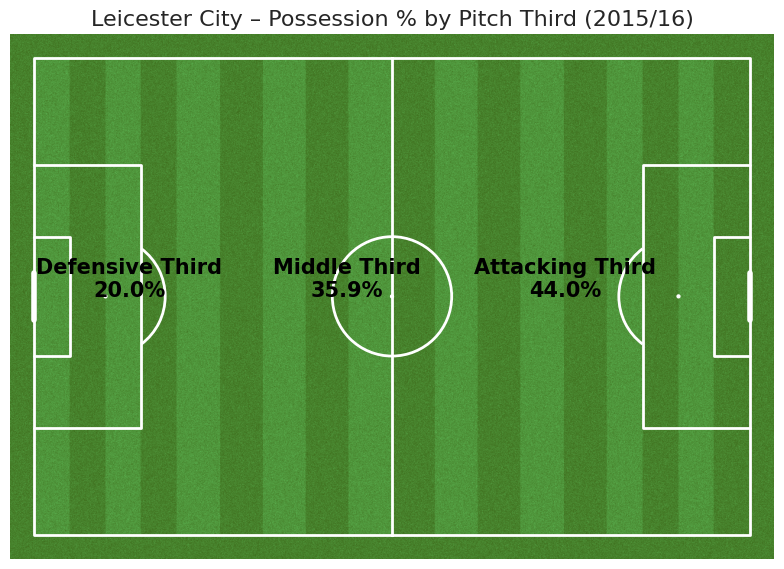

In [66]:
# Visualising Posession Thirds

pitch = Pitch(pitch_type='statsbomb', line_color='white', pitch_color='grass', stripe=True)
fig, ax = pitch.draw(figsize=(8, 6))

pitch.annotate(f'Defensive Third\n{def_pct:.1f}%', xy=(16, 40), ax=ax, fontsize=15, ha='center', color='black', weight='bold')
pitch.annotate(f'Middle Third\n{mid_pct:.1f}%', xy=(52.5, 40), ax=ax, fontsize=15, ha='center', color='black', weight='bold')
pitch.annotate(f'Attacking Third\n{att_pct:.1f}%', xy=(89, 40), ax=ax, fontsize=15, ha='center', color='black', weight='bold')

plt.title("Leicester City – Possession % by Pitch Third (2015/16)", fontsize=16)
plt.tight_layout()
plt.show()


## 5. Shot Maps, Goal Locations & xG Analysis

Despite not taking many shots compared to top sides, Leicester scored frequently — proof of their attacking efficiency.  

This section analyzes:
- Where shots and goals were taken from  
- How many goals came from inside vs. outside the box  
- Expected Goals (xG) for each shot  
- Patterns in shot creation and finishing


In [68]:
# Get all Leicester shot events
lc_shots = lc_events[lc_events['type'] == 'Shot']

# Filter goals
lc_goals = lc_shots[lc_shots['shot_outcome'] == 'Goal']


### 5.1. Summary stats for Shots and Goals

In [69]:
# Inside box goal filter
goals_inside_box = lc_goals[lc_goals['location'].apply(lambda loc: 102 <= loc[0] <= 120 and 18 <= loc[1] <= 62)]
percentage_inside = (len(goals_inside_box) / len(lc_goals)) * 100

print(f"Total shots taken: {len(lc_shots)}")
print(f"Total goals scored: {len(lc_goals)}")
print(f"Goals from inside the box: {len(goals_inside_box)} ({percentage_inside:.2f}%)")


Total shots taken: 525
Total goals scored: 67
Goals from inside the box: 64 (95.52%)


## 5.2. Shot Map & Location

We’ll now plot all shot attempts in red and overlay goals in green.

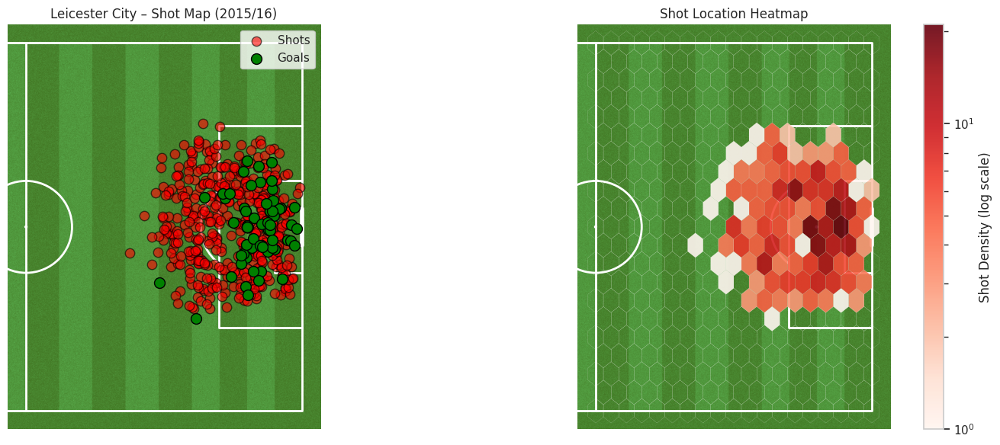

In [71]:
x = lc_shots['location'].apply(lambda loc: loc[0])
y = lc_shots['location'].apply(lambda loc: loc[1])
gx = lc_goals['location'].apply(lambda loc: loc[0])
gy = lc_goals['location'].apply(lambda loc: loc[1])

fig, axs = plt.subplots(1, 2, figsize=(16, 6))

# Half-pitch shot map
pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True, half=True)
pitch.draw(ax=axs[0])

pitch.scatter(x, y, ax=axs[0], color='red', edgecolor='black', s=80, alpha=0.6, label='Shots')
pitch.scatter(gx, gy, ax=axs[0], color='green', edgecolor='black', s=100, label='Goals')

axs[0].set_title('Leicester City – Shot Map (2015/16)')
axs[0].legend(loc='upper right')

# Heatmap version
pitch.draw(ax=axs[1])
hb = axs[1].hexbin(x, y, gridsize=18, extent=(60, 120, 0, 80), cmap='Reds', bins='log', edgecolors='white', linewidths=0.1, alpha=0.9)
cbar = plt.colorbar(hb, ax=axs[1])
cbar.set_label('Shot Density (log scale)')
axs[1].set_title('Shot Location Heatmap')

plt.tight_layout()
plt.show()

### 5.3. xG Distribution

Let’s size each shot by its expected goal value (xG) to understand Leicester’s shot quality.

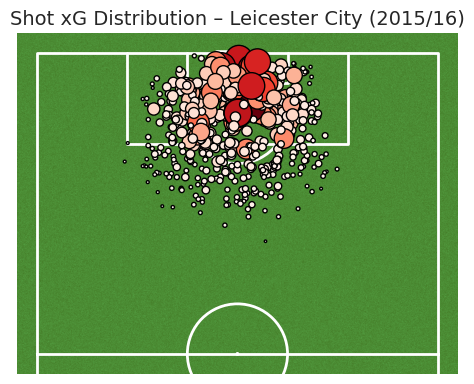

In [73]:
v_pitch = VerticalPitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', half=True)
fig, ax = v_pitch.draw(figsize=(6, 4))

v_pitch.scatter(
    x=lc_shots['location'].apply(lambda x: x[0]),
    y=lc_shots['location'].apply(lambda x: x[1]),
    s=lc_shots['shot_statsbomb_xg'] * 500,
    c=lc_shots['shot_statsbomb_xg'],
    cmap='Reds',
    edgecolors='black',
    ax=ax
)

ax.set_title("Shot xG Distribution – Leicester City (2015/16)", fontsize=14)
plt.show()


### 5.5. Goals by Play Pattern
How did Leicester score? Open play? Set pieces? Counterattacks?  
This breakdown gives a tactical clue into their direct approach.

<ipython-input-74-e021a48e131c>:4: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns_bar = sns.barplot(x=play_patterns.index, y=play_patterns.values, palette='Reds')


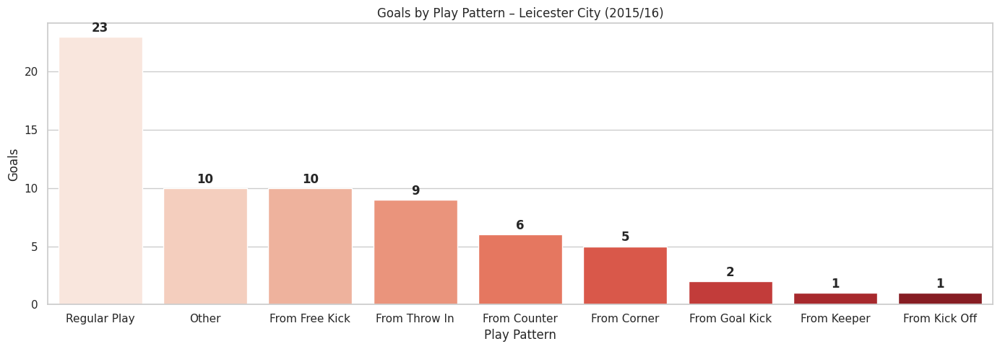

In [74]:
play_patterns = lc_goals['play_pattern'].value_counts()

plt.figure(figsize=(14, 5))
sns_bar = sns.barplot(x=play_patterns.index, y=play_patterns.values, palette='Reds')

for i, value in enumerate(play_patterns.values):
    plt.text(i, value + 0.2, str(value), ha='center', va='bottom', fontweight='bold')

plt.title("Goals by Play Pattern – Leicester City (2015/16)")
plt.ylabel("Goals")
plt.xlabel("Play Pattern")
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


## 6. Key Player Profiles: Vardy, Mahrez, Kanté & Schmeichel

A historic season like Leicester’s was defined by players who played at the peak of their powers.

Let’s analyze:
- 🔥 Jamie Vardy’s goals and movement  
- 🎯 Mahrez’s assists and take-ons  
- 🛡️ Kanté’s pressing and interceptions  
- 🧱 Schmeichel’s shot-stopping ability


In [106]:
# Goals from lc_shots
player_goals = lc_shots[lc_shots['shot_outcome'] == 'Goal']['player'].value_counts()

# Assists from lc_events
player_assists = lc_events[lc_events['pass_goal_assist'] == True]['player'].value_counts()

# Merge and filter for the three players
g_plus_a = pd.merge(player_goals.rename('Goals'),
                    player_assists.rename('Assists'),
                    left_index=True,
                    right_index=True,
                    how='outer').fillna(0)

# Filter only for the three players
key_players = ['Jamie Vardy', 'Riyad Mahrez']  # Unicode apostrophe for Kanté
g_plus_a = g_plus_a.loc[g_plus_a.index.isin(key_players)]

# Compute total G+A
g_plus_a['Goals'] = g_plus_a['Goals'].astype(int)
g_plus_a['Assists'] = g_plus_a['Assists'].astype(int)
g_plus_a['G+A'] = g_plus_a['Goals'] + g_plus_a['Assists']

# Sort by G+A
g_plus_a = g_plus_a.sort_values(by='G+A', ascending=False)

g_plus_a

,Goals,Assists,G+A
player,,,
Jamie Vardy,24,5,29
Riyad Mahrez,17,10,27


### 6.1. Jamie Vardy - Relentless Runner & Finisher
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/c/c1/Jamie_Vardy_2018_%28cropped%29.jpg/250px-Jamie_Vardy_2018_%28cropped%29.jpg" width="180" height="200">

In [75]:
vardy_shots = lc_shots[lc_shots['player'] == 'Jamie Vardy']
vardy_goals = vardy_shots[vardy_shots['shot_outcome'] == 'Goal']

print(len(vardy_goals))

24


Vardy scored 24 goals this season. Let’s visualize his shot map and xG to understand his positioning and efficiency.

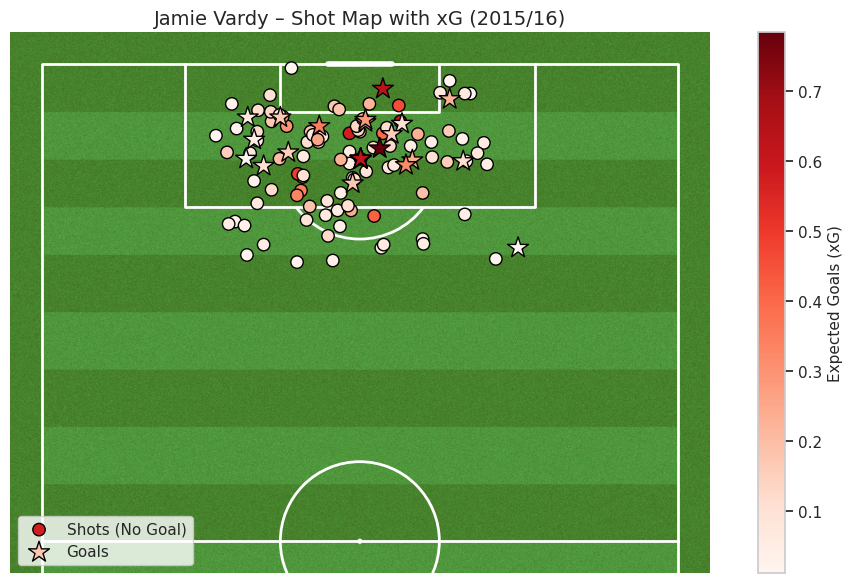

In [101]:
# Normalize xG
norm = mcolors.Normalize(vmin=0, vmax=vardy_shots['shot_statsbomb_xg'].max())
cmap = cm.Reds

# Split shots into goals and non-goals
non_goals = vardy_shots[vardy_shots['shot_outcome'] != 'Goal']
goals = vardy_goals.copy()

# Create plot
pitch = VerticalPitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True, half=True)
fig, ax = pitch.draw(figsize=(10, 6))

# Plot non-goal shots: red circles colored by xG
scatter = pitch.scatter(
    non_goals['location'].apply(lambda x: x[0]),
    non_goals['location'].apply(lambda x: x[1]),
    s=80,
    c=non_goals['shot_statsbomb_xg'],
    cmap='Reds',
    edgecolor='black',
    marker='o',
    ax=ax,
    label='Shots (No Goal)'
)

# Plot goals: green stars colored by xG
pitch.scatter(
    goals['location'].apply(lambda x: x[0]),
    goals['location'].apply(lambda x: x[1]),
    s=250,
    c=goals['shot_statsbomb_xg'],
    cmap='Reds',
    edgecolor='black',
    marker='*',
    ax=ax,
    label='Goals'
)

# Add colorbar for xG
cbar = plt.colorbar(scatter, ax=ax)
cbar.set_label('Expected Goals (xG)', fontsize=11)

# Final touches
ax.set_title("Jamie Vardy – Shot Map with xG (2015/16)", fontsize=14)
ax.legend(loc='lower left')
plt.tight_layout()
plt.show()


### 6.2. Riyadh Mahrez - Creativity Engine

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/b/b6/Alg%C3%A9rie_-_Arm%C3%A9nie_-_20140531_-_Riyad_Mahrez_%28cropped%29.jpg/250px-Alg%C3%A9rie_-_Arm%C3%A9nie_-_20140531_-_Riyad_Mahrez_%28cropped%29.jpg" width="180" height="200">


Mahrez’s left foot and ball control terrorized defenders. Let’s plot his:
- Shot assists (key passes)
- Completed dribbles

In [104]:
# Mahrez key passes
key_passes = lc_events[lc_events['pass_shot_assist'] == True]
mahrez_passes = key_passes[key_passes['player'] == 'Riyad Mahrez']

# Dribbles
mahrez_dribbles = lc_events[(lc_events['type'] == 'Dribble') &
                            (lc_events['dribble_outcome'] == 'Complete') &
                            (lc_events['player'] == 'Riyad Mahrez')]

# Filter Mahrez shots
mahrez_shots = lc_shots[lc_shots['player'] == 'Riyad Mahrez']
mahrez_goals = mahrez_shots[mahrez_shots['shot_outcome'] == 'Goal']
mahrez_non_goals = mahrez_shots[mahrez_shots['shot_outcome'] != 'Goal']

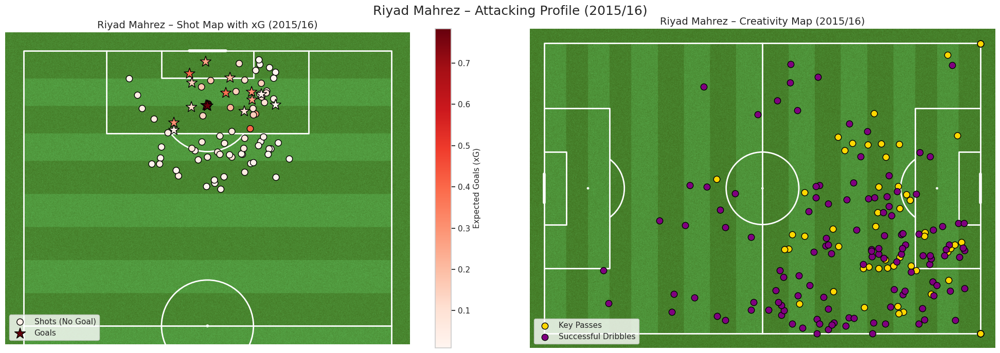

In [105]:
# xG color normalization
norm = mcolors.Normalize(vmin=0, vmax=mahrez_shots['shot_statsbomb_xg'].max())
cmap = cm.Reds

# Create side-by-side plots
fig, axs = plt.subplots(1, 2, figsize=(20, 7))

# Shot Map
v_pitch = VerticalPitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True, half=True)
v_pitch.draw(ax=axs[0])

# Missed shots
scatter1 = v_pitch.scatter(
    mahrez_non_goals['location'].apply(lambda x: x[0]),
    mahrez_non_goals['location'].apply(lambda x: x[1]),
    s=80,
    c=mahrez_non_goals['shot_statsbomb_xg'],
    cmap='Reds',
    edgecolor='black',
    marker='o',
    ax=axs[0],
    label='Shots (No Goal)'
)

# Goals
v_pitch.scatter(
    mahrez_goals['location'].apply(lambda x: x[0]),
    mahrez_goals['location'].apply(lambda x: x[1]),
    s=250,
    c=mahrez_goals['shot_statsbomb_xg'],
    cmap='Reds',
    edgecolor='black',
    marker='*',
    ax=axs[0],
    label='Goals'
)

axs[0].set_title("Riyad Mahrez – Shot Map with xG (2015/16)", fontsize=14)
axs[0].legend(loc='lower left')

# Add colorbar
cbar = plt.colorbar(scatter1, ax=axs[0])
cbar.set_label('Expected Goals (xG)', fontsize=11)

# Creativity Map
pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', stripe=True, line_color='white')
pitch.draw(ax=axs[1])

pitch.scatter(mahrez_passes['location'].apply(lambda x: x[0]),
              mahrez_passes['location'].apply(lambda x: x[1]),
              ax=axs[1], color='gold', s=80, label='Key Passes', edgecolor='black')

pitch.scatter(mahrez_dribbles['location'].apply(lambda x: x[0]),
              mahrez_dribbles['location'].apply(lambda x: x[1]),
              ax=axs[1], color='purple', s=80, label='Successful Dribbles', edgecolor='black')

axs[1].set_title("Riyad Mahrez – Creativity Map (2015/16)", fontsize=14)
axs[1].legend(loc='lower left')

# Final layout
plt.suptitle("Riyad Mahrez – Attacking Profile (2015/16)", fontsize=18)
plt.tight_layout()
plt.show()

### 6.3. N’Golo Kanté – Defensive Workhorse

<img src="https://upload.wikimedia.org/wikipedia/commons/0/05/N%27Golo_Kant%C3%A9_%28cropped%29.jpg" width="180" height="220">

Kanté made more interceptions and tackles than any other player in the league. Let’s visualize his defensive actions.

In [118]:
# Fix player name and filter Kanté events
kante_events = lc_events[lc_events['player'].str.contains("Kanté", na=False)]

# Defensive actions
kante_tackles = kante_events[kante_events['duel_type'] == 'Tackle']
kante_interceptions = kante_events[kante_events['type'] == 'Interception']
kante_fouls = kante_events[kante_events['type'] == 'Foul Committed']

# Filter Kanté's dribbles and carries
kante_carries = lc_events[(lc_events['player'].str.contains("Kanté", na=False)) & (lc_events['type'] == 'Carry')]
kante_dribbles = lc_events[(lc_events['player'].str.contains("Kanté", na=False)) &
                           (lc_events['type'] == 'Dribble') &
                           (lc_events['dribble_outcome'] == 'Complete')]

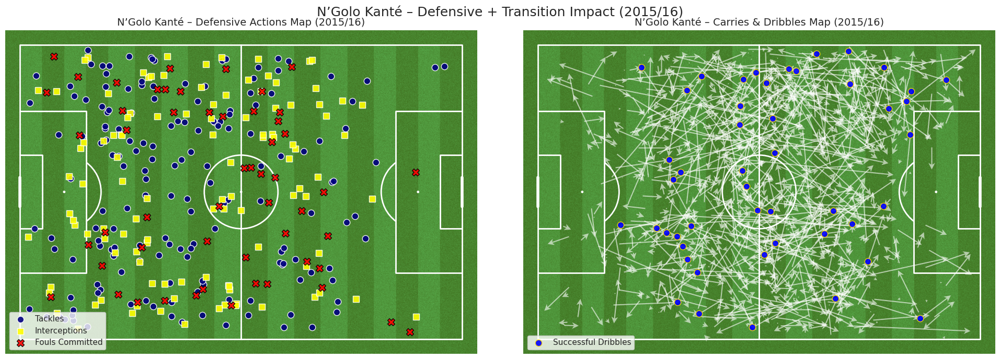

In [124]:
# Create side-by-side plot
fig, axs = plt.subplots(1, 2, figsize=(20, 7))
pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', stripe=True, line_color='white')

# ----------------------
# Left: Defensive Actions
# ----------------------
pitch.draw(ax=axs[0])

pitch.scatter(
    kante_tackles['location'].apply(lambda x: x[0]),
    kante_tackles['location'].apply(lambda x: x[1]),
    ax=axs[0], color='navy', marker='o', s=80, label='Tackles', edgecolor='white', alpha=0.9
)

pitch.scatter(
    kante_interceptions['location'].apply(lambda x: x[0]),
    kante_interceptions['location'].apply(lambda x: x[1]),
    ax=axs[0], color='yellow', marker='s', s=80, label='Interceptions', edgecolor='white', alpha=0.9
)

pitch.scatter(
    kante_fouls['location'].apply(lambda x: x[0]),
    kante_fouls['location'].apply(lambda x: x[1]),
    ax=axs[0], color='red', marker='X', s=100, label='Fouls Committed', edgecolor='black', alpha=0.9
)

axs[0].set_title("N’Golo Kanté – Defensive Actions Map (2015/16)", fontsize=14)
axs[0].legend(loc='lower left')

# ----------------------
# Right: Dribbles and Carries
# ----------------------
pitch.draw(ax=axs[1])

# Carries – white arrows
for _, row in kante_carries.iterrows():
    if isinstance(row['location'], list) and isinstance(row['carry_end_location'], list):
        pitch.arrows(row['location'][0], row['location'][1],
                     row['carry_end_location'][0], row['carry_end_location'][1],
                     ax=axs[1], color='white', alpha=0.6, width=1.5, headwidth=6, headlength=6)

# Dribbles – blue dots
pitch.scatter(
    kante_dribbles['location'].apply(lambda x: x[0]),
    kante_dribbles['location'].apply(lambda x: x[1]),
    ax=axs[1], color='blue', marker='o', s=80, edgecolor='gold', label='Successful Dribbles', alpha=0.9
)

axs[1].set_title("N’Golo Kanté – Carries & Dribbles Map (2015/16)", fontsize=14)
axs[1].legend(loc='lower left')

# Final layout
plt.suptitle("N’Golo Kanté – Defensive + Transition Impact (2015/16)", fontsize=18)
plt.tight_layout()
plt.show()

### 6.4. Kasper Schmeichel – The Final Barrier

<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/9/95/Kasper_Schmeichel_Celtic-20240722_%28cropped%29.jpg/250px-Kasper_Schmeichel_Celtic-20240722_%28cropped%29.jpg" width="180" height="220">

Let’s use a radar plot to summarize Schmeichel’s goalkeeping attributes.

In [153]:
# Extract all shots against Leicester City
opponent_shots = pd.DataFrame(columns=example_event.columns)

for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    events = sb.events(match_id=match_id)

    # Get shots from the *opponent team*
    if match['home_team'] == 'Leicester City':
        opponent_team = match['away_team']
    else:
        opponent_team = match['home_team']

    shots = events[(events['team'] == opponent_team) & (events['type'] == 'Shot')]
    opponent_shots = pd.concat([opponent_shots, shots], ignore_index=True)

print(f"Total shots faced by Leicester: {len(opponent_shots)}")
print("Shot outcome breakdown:\n", opponent_shots['shot_outcome'].value_counts())


<ipython-input-153-b32bdacce216>:15: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



Total shots faced by Leicester: 517
Shot outcome breakdown:
 shot_outcome
Blocked             176
Off T               165
Saved               100
Goal                 36
Wayward              27
Post                  8
Saved Off Target      3
Saved to Post         2
Name: count, dtype: int64


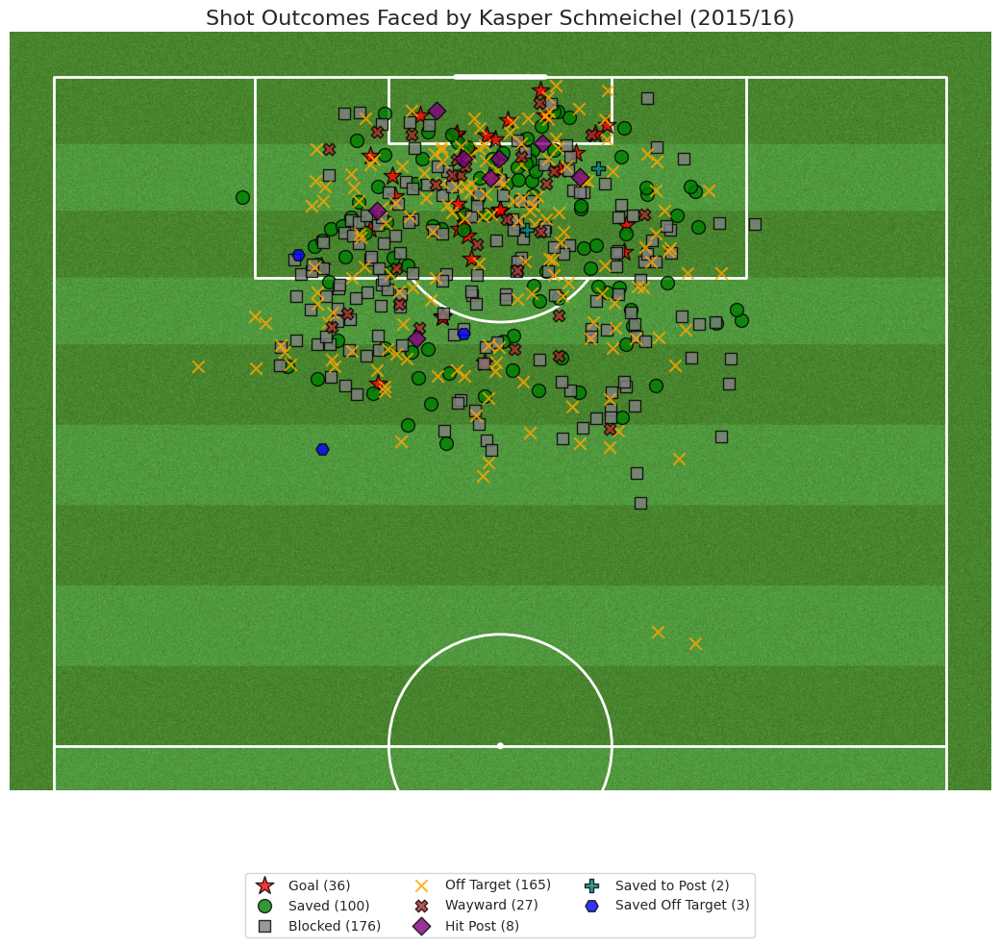

In [177]:
# Define mapping for each outcome
outcome_styles = {
    'Goal':            {'color': 'red',      'marker': '*', 'label': 'Goal', 'size': 200},
    'Saved':           {'color': 'green',    'marker': 'o', 'label': 'Saved', 'size': 100},
    'Blocked':         {'color': 'gray',     'marker': 's', 'label': 'Blocked', 'size': 80},
    'Off T':           {'color': 'orange',   'marker': 'x', 'label': 'Off Target', 'size': 80},
    'Wayward':         {'color': 'brown',    'marker': 'X', 'label': 'Wayward', 'size': 80},
    'Post':            {'color': 'purple',   'marker': 'D', 'label': 'Hit Post', 'size': 90},
    'Saved to Post':   {'color': 'teal',     'marker': 'P', 'label': 'Saved to Post', 'size': 90},
    'Saved Off Target':{'color': 'blue',     'marker': 'H', 'label': 'Saved Off Target', 'size': 90},
}

# Setup pitch
pitch = VerticalPitch(pitch_type='statsbomb', pitch_color='grass', line_color='white', stripe=True, half=True)
fig, ax = pitch.draw(figsize=(18, 10))

# Plot each outcome type
for outcome, style in outcome_styles.items():
    df = opponent_shots[opponent_shots['shot_outcome'] == outcome]
    if not df.empty:
        pitch.scatter(
            df['location'].apply(lambda x: x[0]),
            df['location'].apply(lambda x: x[1]),
            ax=ax,
            color=style['color'],
            marker=style['marker'],
            s=style['size'],
            label=f"{style['label']} ({len(df)})",
            edgecolor='black',
            alpha=0.8
        )

# Title and legend
ax.set_title("Shot Outcomes Faced by Kasper Schmeichel (2015/16)", fontsize=16)
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1), ncol=3, fontsize=10)
plt.tight_layout()
plt.show()


In [159]:
# Classify each shot faced into zones
def classify_zone(loc):
    if not isinstance(loc, list):
        return 'Unknown'
    x, y = loc
    if x > 102 and 36 <= y <= 44:
        return '6-yard Box'
    elif 102 < x <= 120:
        return 'Penalty Box'
    elif x <= 102:
        return 'Outside Box'
    return 'Unknown'

opponent_shots['zone'] = opponent_shots['location'].apply(classify_zone)
opponent_shots['is_goal'] = opponent_shots['shot_outcome'] == 'Goal'
opponent_shots['is_saved'] = opponent_shots['shot_outcome'] == 'Saved'


<ipython-input-159-075ff0a459b4>:14: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<ipython-input-159-075ff0a459b4>:15: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`

<ipython-input-159-075ff0a459b4>:16: PerformanceWarning:

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`



In [162]:
# Compute save % per zone
zone_summary = opponent_shots.groupby('zone').agg(
    shots_faced=('id', 'count'),
    goals_conceded=('is_goal', 'sum'),
    saves=('is_saved', 'sum'),
    total_xg=('shot_statsbomb_xg', 'sum')
).reset_index()

zone_summary['save_pct'] = (zone_summary['saves'] / zone_summary['shots_faced']) * 100
zone_summary['goals_prevented'] = zone_summary['total_xg'] - zone_summary['goals_conceded']
zone_summary = zone_summary.sort_values(by='shots_faced', ascending=False)
zone_summary


,zone,shots_faced,goals_conceded,saves,total_xg,save_pct,goals_prevented
2,Penalty Box,210,12,43,18.532743,20.476190,6.532743
1,Outside Box,195,4,35,6.580867,17.948718,2.580867
0,6-yard Box,112,20,22,21.019941,19.642857,1.019941


<ipython-input-165-eb41c5a5a132>:5: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




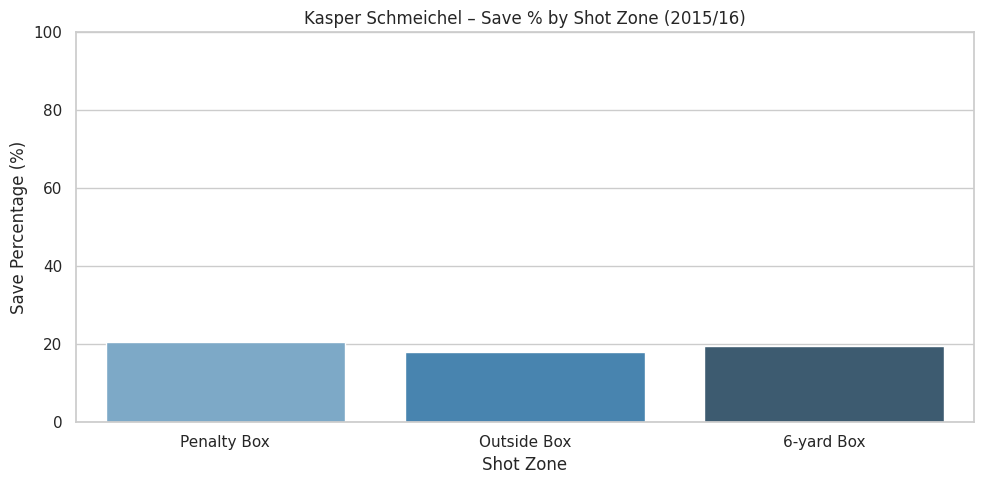

In [165]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
sns.barplot(data=zone_summary, x='zone', y='save_pct', palette='Blues_d')

plt.title("Kasper Schmeichel – Save % by Shot Zone (2015/16)")
plt.ylabel("Save Percentage (%)")
plt.xlabel("Shot Zone")
plt.ylim(0, 100)
plt.tight_layout()
plt.show()


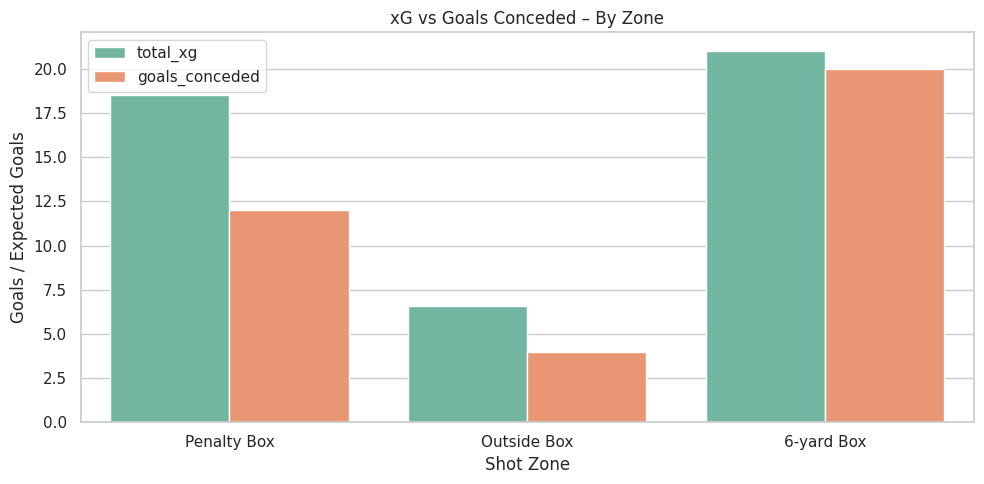

In [169]:
plt.figure(figsize=(10, 5))
bar1 = sns.barplot(data=zone_summary.melt(id_vars='zone', value_vars=['total_xg', 'goals_conceded']),
                   x='zone', y='value', hue='variable', palette='Set2')
plt.title("xG vs Goals Conceded – By Zone")
plt.ylabel("Goals / Expected Goals")
plt.xlabel("Shot Zone")
plt.legend(title='')
plt.tight_layout()
plt.show()


## 7. Match Moments & Goals Analysis

In this section, we’ll:
- Create a 5-minute bin chart to find when they were most dangerous
- Key Sequences leading to Goals (involving Mahrez, Kante and Vardy)

In [94]:
# Initialize timeline
goal_timeline = defaultdict(int)

for _, match in lc_matches.iterrows():
    match_id = match['match_id']
    events = sb.events(match_id=match_id)

    for _, event in events.iterrows():
        if event['team'] == 'Leicester City' and event['type'] == 'Shot' and event.get('shot_outcome') == 'Goal':
            minute = event['minute']
            goal_timeline[minute] += 1

# Convert to DataFrame
goal_minute_df = pd.DataFrame(list(goal_timeline.items()), columns=['minute', 'goals']).sort_values(by='minute').reset_index(drop=True)


### Goals by 5-Minute Interval

This shows which 5-minute window Leicester scored the most — e.g. just before halftime or right after the break.


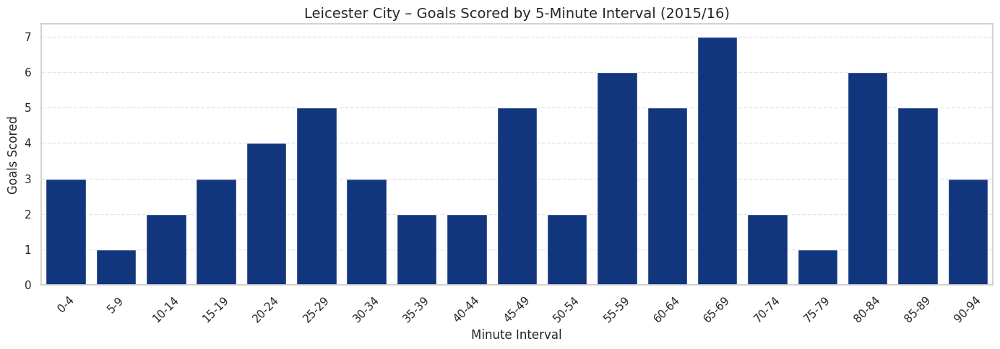

In [96]:
goal_minute_df['minute_bin'] = (goal_minute_df['minute'] // 5) * 5
binned_goals = goal_minute_df.groupby('minute_bin')['goals'].sum().reset_index()

# Label bins
binned_goals['label'] = binned_goals['minute_bin'].apply(lambda x: f"{x}-{x+4}")

plt.figure(figsize=(14, 5))
sns.barplot(data=binned_goals, x='label', y='goals', color=blue)

plt.title("Leicester City – Goals Scored by 5-Minute Interval (2015/16)", fontsize=14)
plt.xlabel("Minute Interval")
plt.ylabel("Goals Scored")
plt.xticks(rotation=45)
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()


Leicester were mentally strong. Their goals often came:
- At **crucial first-half moments** to seize momentum
- Or **late in the second half** to secure wins

Leicester often scored in bursts, especially in the 15–30 , 50-70 and 75–90 minute ranges. Their direct style paid off as defenders tired.

This supports the idea of a well-drilled team that could *both strike early* and *close strong*.

### Key Sequences leading to Goals (involving Mahrez, Kante and Vardy)


In [181]:
# Get all Leicester events with regular play
leicester_events = lc_events[(lc_events['team'] == 'Leicester City') & (lc_events['play_pattern'] == 'Regular Play')]

# Filter all goal events
leicester_goals = leicester_events[(leicester_events['type'] == 'Shot') &
                                   (leicester_events['shot_outcome'] == 'Goal')]

print(f"Total goals: {len(leicester_goals)}")


Total goals: 23


<ipython-input-184-b13ba59f98ff>:17: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.



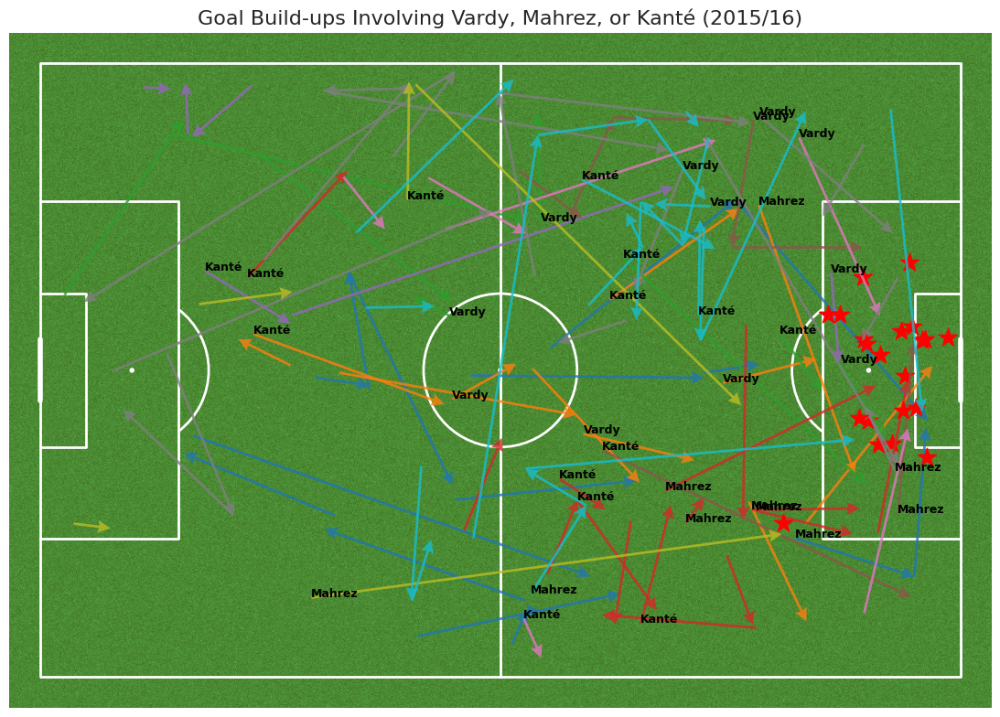

In [184]:
key_players = ['Jamie Vardy', 'Riyad Mahrez', "N''Golo Kanté"]

buildups = []
for _, goal in leicester_goals.iterrows():
    match_id = goal['match_id']
    possession_id = goal['possession']

    possession_events = lc_events[(lc_events['match_id'] == match_id) &
                                  (lc_events['possession'] == possession_id) &
                                  (lc_events['team'] == 'Leicester City')]

    if possession_events['player'].isin(key_players).any():
        buildups.append(possession_events)

# Assign colors and set up pitch
num_goals = len(buildups)
colors = cm.get_cmap('tab10', num_goals)  # 10 distinct colors
pitch = Pitch(pitch_type='statsbomb', pitch_color='grass', line_color='white')
fig, ax = pitch.draw(figsize=(12, 8))

# Plot each build-up
for i, buildup in enumerate(buildups):
    passes = buildup[buildup['type'] == 'Pass']
    color = colors(i)

    # Plot each pass in the build-up
    for _, row in passes.iterrows():
        if isinstance(row['location'], list) and isinstance(row.get('pass_end_location'), list):
            x1, y1 = row['location']
            x2, y2 = row['pass_end_location']
            player = row.get('player', 'Unknown')

            pitch.arrows(x1, y1, x2, y2, color=color, ax=ax, width=2, headwidth=5, alpha=0.8)

            # Label only key players
            if player in key_players:
                ax.text(x1, y1, player.split()[-1], fontsize=9, color='black', alpha=1, weight='bold')

    # Plot goal location as red star
    goal_event = buildup[buildup['type'] == 'Shot'].iloc[-1]
    if isinstance(goal_event['location'], list):
        pitch.scatter(goal_event['location'][0], goal_event['location'][1],
                      s=220, marker='*', color='red', ax=ax)

ax.set_title("Goal Build-ups Involving Vardy, Mahrez, or Kanté (2015/16)", fontsize=16)
plt.tight_layout()
plt.show()

## 8. Tactical Summary & Key Takeaways

Leicester City's 2015–16 title win wasn't a fluke. It was the result of a **brilliantly optimized system** built around efficiency, discipline, and explosiveness.

Here’s what the data tells us:
### 🔍 Tactical Identity
- 🧱 **Formation**: A stable 4-4-2 across almost every game.
- 🧠 **Defensive Block**: Compact and deep — players rarely stepped out of shape.
- ⚔️ **Attack Pattern**: Minimal touches, vertical passes, wide overloads via Mahrez.

### 🕸️ Possession Strategy
- 🧊 **Possession? No Thanks** – Averaged ~43%, but chose **when** to have the ball.
- 🧠 **Territory Use**: Majority of touches in the middle third before bursting forward.

### ⚡ Build-Up & Chance Creation
- 🎯 **Few Passes, More Impact** – Quick transitions from Kanté to Mahrez to Vardy.
- 📍 **Shot Map**: Focused inside the box; high xG per shot.

### ⭐ Key Players
- ⚡ **Vardy**: Devastating with space; converted low xG chances consistently.
- 🎩 **Mahrez**: Created, dribbled, and scored – 17 goals, 11 assists.
- 🛡️ **Kanté**: League-leading in tackles/interceptions – the glue of midfield.
- 🧤 **Schmeichel**: Commanded the box and launched counterattacks with his kicking.

### 🧠 Mentality
- 💪 **Clutch Goals**: Many winners came in the second half.
- 📊 **Fewest Defeats in League**: Lost just 3 matches.

---

> 🏆 **In a league dominated by possession and stars, Leicester played to their strengths. They didn’t want to control the game — they wanted to win it.**
